# Setup

In [4]:
import pandas as pd
import numpy as np
import random
import networkx as nx
import matplotlib.pyplot as plt

#### Class Definition

In [4]:
class Vertex:
    def __init__(self, id_=""):
        self.id_ = id_
        self.neighbours = {}
    
    def add_neighbour(self, nbr_vertex, weight=0):
        self.neighbours[nbr_vertex] = weight
    
    def get_vertex_neighbours(self):
        # return list(self.neighbours.keys())
        return (self.neighbours.keys())
    
    def get_weight(self, neighbour):
        if neighbour in self.neighbours.keys():
            return self.neighbours[neighbour]
        return None
    
    def __eq__(self, other):
        if self.id_ == other.id_: 
            return True
        return False

    def __lt__(self, other):
        if self.id_ < other.id_:
            return True
        return False

    def __hash__(self):
        return hash(self.id_)
    
    def __str__(self):
        my_string = f"Vertex {self.id_} is connected to: "
        my_neighbours = []
        for vertex in self.get_vertex_neighbours():
            my_neighbours.append(vertex.id_)
        my_string += ", ".join(my_neighbours)
        return my_string
    
class Graph:
    def __init__(self):
        self.vertices = {}
        
    def _create_vertex(self, id_):
        return Vertex(id_)

    def add_vertex(self, id_):
        self.vertices[id_] = self._create_vertex(id_)

    def get_vertex(self, id_):
        if id_ in self.vertices.keys():
            return self.vertices[id_]
        return None
        
    def add_edge(self, start_v, end_v, weight=0):
        if not start_v in self.vertices: 
            self.add_vertex(start_v)
        if not end_v in self.vertices: 
            self.add_vertex(end_v)
        v_start = self.vertices[start_v]
        v_end = self.vertices[end_v]
        v_start.add_neighbour(v_end)

    def get_neighbours(self, id_):
        vertex = self.get_vertex(id_)
        if vertex:
            return [neighbour.id_ for neighbour in vertex.get_vertex_neighbours()]
        return None
 
    def __contains__(self, id_):
        return (id_ in self.vertices)
    
    def __iter__(self):
        for k,v in self.vertices.items():
            yield v 

    @property        
    def num_vertices(self):
        return len(self.vertices)

# Generating Precedence Constraints 

### 01 First Try

In [5]:
def visualize_graph(graph, figure_size=(8, 6), edge_color='black', alpha=0.8):
    G = nx.DiGraph()
    
    for vertex in graph:
        G.add_node(vertex.id_)
        for neighbour in vertex.get_vertex_neighbours():
            G.add_edge(vertex.id_, neighbour.id_)
    
    plt.figure(figsize=figure_size)
    pos = nx.spring_layout(G)
    nx.draw(G, pos, with_labels=True, node_color='black', font_weight='black', node_size=700, font_size=10, edge_color=edge_color, alpha=alpha)
    plt.show()

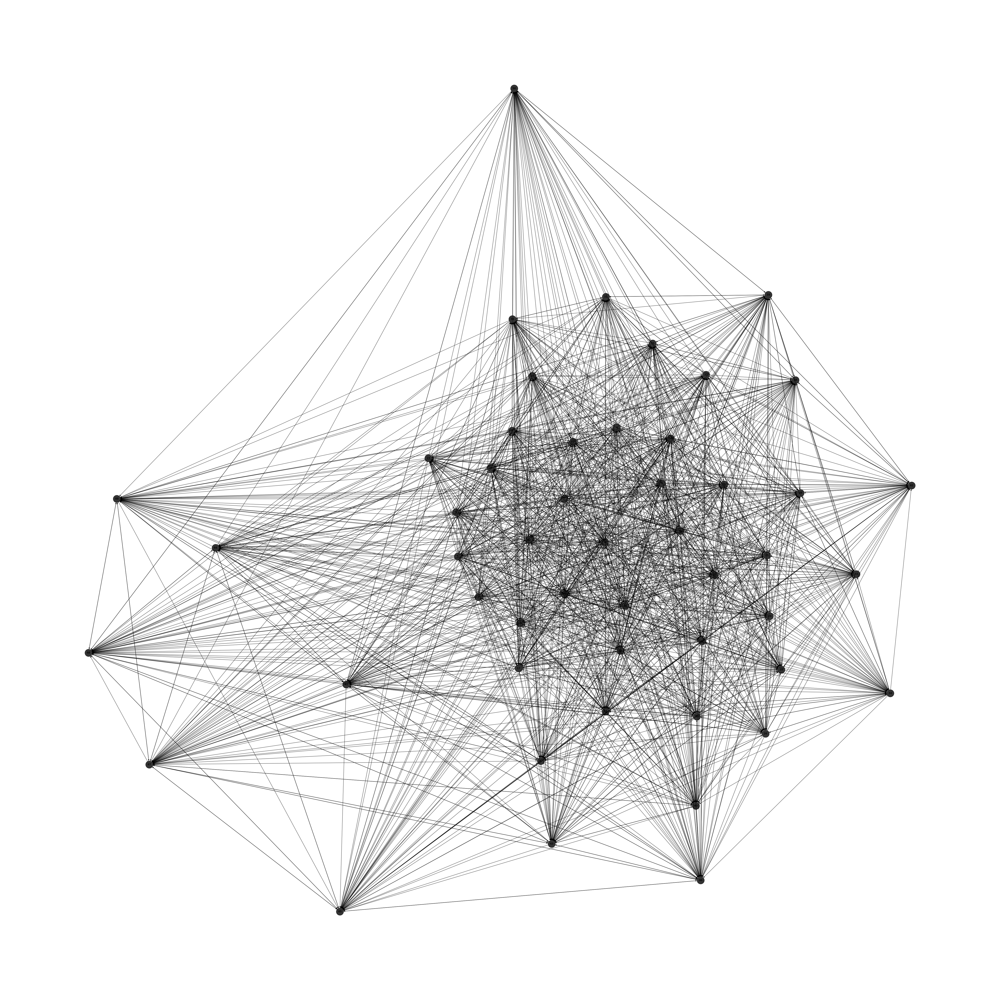

In [6]:
D = 0.2
n = 50

p_ij = {}
for i in range(1, n+1):
    p_ij[i] = {}
    for j in range(1, n+1):
        if j != i: 
            p_ij[i][j] = D*(1-D)**(j-i-1) / (1 - D * (1 - (1-D)**(j-i-1) ))

g = Graph()
for i in range(1, n+1): 
    for j in range(1, n+1):
        if (i != j) and (p_ij[i][j] <= random.random()):
            g.add_edge(str(i),str(j))

if n <= 10: 
    for vertex in g: 
        print(vertex)
visualize_graph(g, figure_size=(50,50))


### 02 Second Try

In [7]:
class Vertex:
    def __init__(self, id_=""):
        self.id_ = id_
        self.neighbours = {}
    
    def add_neighbour(self, nbr_vertex, weight=0):
        self.neighbours[nbr_vertex] = weight
    
    def get_vertex_neighbours(self):
        return self.neighbours.keys()
    
    def get_weight(self, neighbour):
        if neighbour in self.neighbours.keys():
            return self.neighbours[neighbour]
        return None
    
    def __eq__(self, other):
        return self.id_ == other.id_

    def __lt__(self, other):
        return self.id_ < other.id_

    def __hash__(self):
        return hash(self.id_)
    
    def __str__(self):
        my_string = f"Vertex {self.id_} is connected to: "
        my_neighbours = [vertex.id_ for vertex in self.get_vertex_neighbours()]
        my_string += ", ".join(my_neighbours)
        return my_string
    
class Graph:
    def __init__(self):
        self.vertices = {}
        
    def _create_vertex(self, id_):
        return Vertex(id_)

    def add_vertex(self, id_):
        self.vertices[id_] = self._create_vertex(id_)

    def get_vertex(self, id_):
        return self.vertices.get(id_, None)
        
    def add_edge(self, start_v, end_v, weight=0):
        if start_v not in self.vertices: 
            self.add_vertex(start_v)
        if end_v not in self.vertices: 
            self.add_vertex(end_v)
        v_start = self.vertices[start_v]
        v_end = self.vertices[end_v]
        v_start.add_neighbour(v_end)

    def get_neighbours(self, id_):
        vertex = self.get_vertex(id_)
        if vertex:
            return [neighbour.id_ for neighbour in vertex.get_vertex_neighbours()]
        return []
 
    def __contains__(self, id_):
        return id_ in self.vertices
    
    def __iter__(self):
        return iter(self.vertices.values())

    @property        
    def num_vertices(self):
        return len(self.vertices)

In [8]:
list = [(1, 2), (3, 4), (45,0)]
for u, v in list: 
    print(u, v)

1 2
3 4
45 0


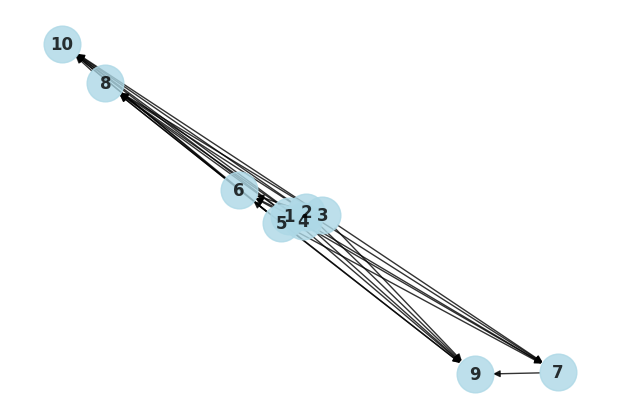

{'1': ['3', '4', '5', '6', '7', '8', '9', '10'], '2': ['4', '5', '6', '7', '8', '9', '10'], '3': ['7', '8', '9', '10'], '4': ['6', '7', '8', '9', '10'], '5': ['6', '7', '8', '9', '10'], '6': ['8', '9', '10'], '7': ['9'], '8': ['10'], '9': [], '10': []}


In [9]:
import networkx as nx
import matplotlib.pyplot as plt
import random

D = 0.9
n = 10

p_ij = {}
for i in range(1, n+1):
    p_ij[i] = {}
    for j in range(1, n+1):
        if j != i: 
            p_ij[i][j] = D*(1-D)**(j-i-1) / (1 - D * (1 - (1-D)**(j-i-1) ))

def generate_graph(n, p_ij, dict_graph):
    g = Graph()
    edges = []

    for i in range(1, n):
        dict_graph[str(i)] = []
        for j in range(i + 1, n + 1):
            dict_graph[str(j)] = []
            if p_ij[i][j] <= random.random():
                edges.append((i, j))

    for u, v in edges:
        u, v = str(u), str(v)
        if u < v:
            if not any(g.get_vertex(str(w)) for w in g.get_neighbours(v) if g.get_vertex(u) in g.get_neighbours(w)):
                g.add_edge(u, v)
                dict_graph[u].append(v)
        else:
            if not any(g.get_vertex(str(w)) for w in g.get_neighbours(u) if g.get_vertex(v) in g.get_neighbours(w)):
                g.add_edge(u, v)
                dict_graph[u].append(v)
    return g


dict_graph = {}
g = generate_graph(n, p_ij, dict_graph)

# Visualization code
def visualize_graph(graph, figure_size=(8, 6), edge_color='lightgrey', edge_alpha=0.5):
    G = nx.DiGraph()
    
    for vertex in graph:
        G.add_node(vertex.id_)
        for neighbour in vertex.get_vertex_neighbours():
            G.add_edge(vertex.id_, neighbour.id_)
    
    plt.figure(figsize=figure_size)
    pos = nx.spring_layout(G)
    nx.draw(G, pos, with_labels=True, node_color='lightblue', font_weight='bold', node_size=700, font_size=12,
            edge_color=edge_color, alpha=edge_alpha)
    plt.show()

# Example usage with custom figure size and softer edge colors
fig_size = (6,4)
visualize_graph(g, figure_size=fig_size, edge_color='black', edge_alpha=0.8)

print(dict_graph)

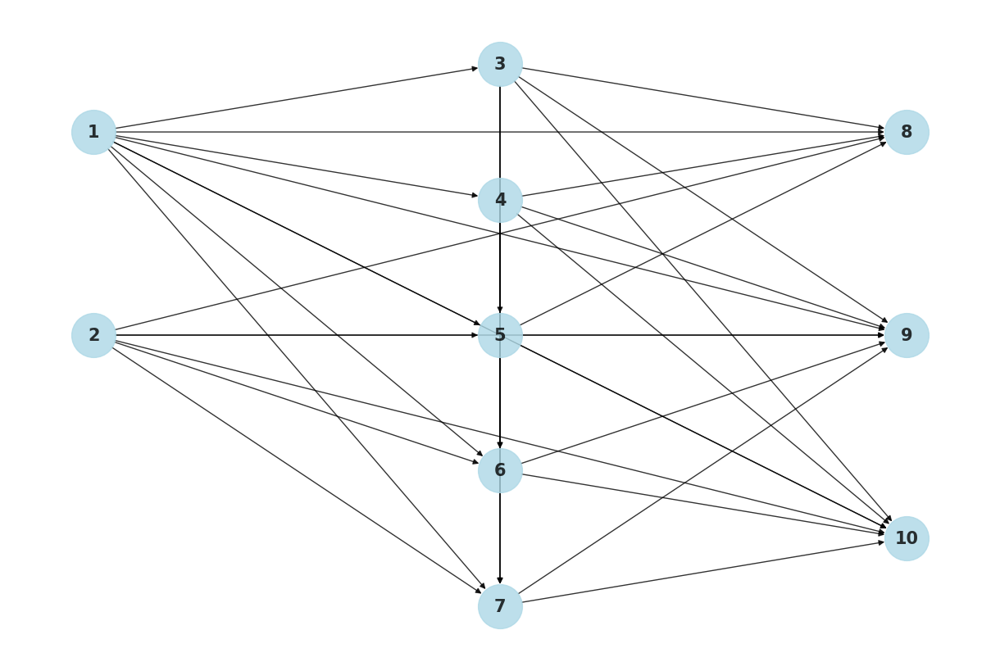

{'1': ['3', '4', '5', '6', '7', '8', '9', '10'], '2': ['5', '6', '7', '8', '9', '10'], '3': ['5', '6', '7', '8', '9', '10'], '4': ['6', '7', '8', '9', '10'], '5': ['7', '8', '9', '10'], '6': ['9', '10'], '7': ['9', '10'], '8': [], '9': [], '10': []}


In [10]:
def visualize_graph(graph, figure_size=(8, 6), edge_color='lightgrey', edge_alpha=0.5):
    G = nx.DiGraph()
    
    for vertex in graph:
        G.add_node(vertex.id_)
        for neighbour in vertex.get_vertex_neighbours():
            G.add_edge(vertex.id_, neighbour.id_)
    
    # Create custom positions for nodes
    pos = {}
    nodes_without_predecessors = [node for node in G.nodes if G.in_degree(node) == 0]
    nodes_without_successors = [node for node in G.nodes if G.out_degree(node) == 0]
    other_nodes = [node for node in G.nodes if node not in nodes_without_predecessors and node not in nodes_without_successors]
    
    x_left = -1.0
    x_right = 1.0
    y_step = 2 / (max(len(nodes_without_predecessors), len(nodes_without_successors)) + 1)
    
    for i, node in enumerate(nodes_without_predecessors):
        pos[node] = (x_left, 1 - (i + 1) * y_step)
    for i, node in enumerate(nodes_without_successors):
        pos[node] = (x_right, 1 - (i + 1) * y_step)
    
    x_middle = 0
    y_middle_step = 2 / (len(other_nodes) + 1)
    
    for i, node in enumerate(other_nodes):
        pos[node] = (x_middle, 1 - (i + 1) * y_middle_step)
    
    plt.figure(figsize=figure_size)
    nx.draw(G, pos, with_labels=True, node_color='lightblue', font_weight='bold', node_size=1500, font_size=15,
            edge_color=edge_color, alpha=edge_alpha)
    plt.show()

g = generate_graph(n, p_ij, dict_graph)
fig_size = (12, 8)
visualize_graph(g, figure_size=fig_size, edge_color='black', edge_alpha=0.8)
print(dict_graph)


### 03 Generation 3

#### Class Definition

In [11]:
class Vertex:
    def __init__(self, id_=""):
        self.id_ = id_
        self.neighbours = {}
    
    def add_neighbour(self, nbr_vertex, weight=0):
        self.neighbours[nbr_vertex] = weight
    
    def get_vertex_neighbours(self):
        return self.neighbours.keys()
    
    def get_weight(self, neighbour):
        if neighbour in self.neighbours.keys():
            return self.neighbours[neighbour]
        return None
    
    def __eq__(self, other):
        return self.id_ == other.id_

    def __lt__(self, other):
        return self.id_ < other.id_

    def __hash__(self):
        return hash(self.id_)
    
    def __str__(self):
        my_string = f"Vertex {self.id_} is connected to: "
        my_neighbours = [vertex.id_ for vertex in self.get_vertex_neighbours()]
        my_string += ", ".join(my_neighbours)
        return my_string
    
class Graph:
    def __init__(self):
        self.vertices = {}
        
    def _create_vertex(self, id_):
        return Vertex(id_)

    def add_vertex(self, id_):
        self.vertices[id_] = self._create_vertex(id_)

    def get_vertex(self, id_):
        return self.vertices.get(id_, None)
        
    def add_edge(self, start_v, end_v, weight=0):
        if start_v not in self.vertices: 
            self.add_vertex(start_v)
        if end_v not in self.vertices: 
            self.add_vertex(end_v)
        v_start = self.vertices[start_v]
        v_end = self.vertices[end_v]
        v_start.add_neighbour(v_end)

    def get_neighbours(self, id_):
        vertex = self.get_vertex(id_)
        if vertex:
            return [neighbour.id_ for neighbour in vertex.get_vertex_neighbours()]
        return []
 
    def __contains__(self, id_):
        return id_ in self.vertices
    
    def __iter__(self):
        return iter(self.vertices.values())

    @property        
    def num_vertices(self):
        return len(self.vertices)

#### Graph Generation

In [12]:
def generate_probabilities(D=0.5, n=10):
    """ 
    Generates the probabilities of arc (i,j) existing for all i, j in n where i =/= j 
    Probability values are generated based on (Hall & Posner, 2001)
    Inputs: 
        - D          : float, value between 0 and 1 which sets the density of the graph
        - n          : int, number of nodes to be generated
    Output: 
        Returns p_ij, a dictionary which stores the probability values using the following data structure: 
            p_ij = { i: {j: p_ij} }
    """
    p_ij = {}
    n = int(n)
    for i in range(1, n+1):
        p_ij[i] = {}
        for j in range(1, n+1):
            if j != i: 
                p_ij[i][j] = D*(1-D)**(j-i-1) / (1 - D * (1 - (1-D)**(j-i-1) ))
    return p_ij 

def generate_graph(n, p_ij, dict_graph={}):
    """ 
    Generates a new graph with arcs and nodes that represent a BOM network. 
    The BOM network is generated based on a given set of probability values (Hall & Posner, 2001)
    Inputs: 
        - n          : int, number of nodes in the graph 
        - p_ij       : dict, probability of arc (i,j) existing (p_ij = { i: {j: p_ij}})
        - dict_graph : dict, alternative method to store graph information using adjacency matrix 
    Output: 
        - g          : graph object containing node and edges information
        - dict_graph : no output, but dict_graph is processed in place 
    Specific Features:
        - The graph generated does not contain self-connecting cycles
    """

    g = Graph()
    edges = []

    for i in range(1, n):
        dict_graph[str(i)] = []
        for j in range(i + 1, n + 1):
            dict_graph[str(j)] = []
            if p_ij[i][j] <= random.random():
                edges.append((i, j))

    for u, v in edges:
        u, v = str(u), str(v)
        if u < v:
            if not any(g.get_vertex(str(w)) for w in g.get_neighbours(v) if g.get_vertex(u) in g.get_neighbours(w)):
                g.add_edge(u, v)
                dict_graph[u].append(v)
        else:
            if not any(g.get_vertex(str(w)) for w in g.get_neighbours(u) if g.get_vertex(v) in g.get_neighbours(w)):
                g.add_edge(u, v)
                dict_graph[u].append(v)
    return g

def visualize_graph(graph, figure_size=(8, 6), font_type="Century Gothic", font_size=15, node_size=1500, node_color='lightblue', edge_color='black', alpha=1):
    """ 
    Generates a visualization for a graph object. The visualization is made in such a way that: 
        (1) Nodes with no immediate predecessors are placed to the left of the image
        (2) Nodes with no immediate successors are placed to the right of the image 
        (3) All other remaining nodes are placed in between. 
    Inputs (Required): 
        - graph         : graph object, containing the nodes and edges to be visualized
    Inputs (Optional):
        - figure_size   : tuple, sets the preferred size of the image
        - font_type     : str, sets the font family
        - font_size     : float, sets the size of the font
        - node_size     : float, sets the size of the nodes
        - node_color    : str, sets the color of the nodes
        - edge_color    : str, sets the color of the edges
        - edge_alpha    : float, value between 0 and 1 which sets the density of the edges
    Output: 
        - Visualization of the graph using plt.show()
    """
    G = nx.DiGraph()
    
    for vertex in graph:
        G.add_node(vertex.id_)
        for neighbour in vertex.get_vertex_neighbours():
            G.add_edge(vertex.id_, neighbour.id_)
    
    # Create custom positions for nodes
    pos = {}
    nodes_without_predecessors = [node for node in G.nodes if G.in_degree(node) == 0]
    nodes_without_successors = [node for node in G.nodes if G.out_degree(node) == 0]
    other_nodes = [node for node in G.nodes if node not in nodes_without_predecessors and node not in nodes_without_successors]
    
    # Assign layers
    layers = {node: 0 for node in nodes_without_predecessors}
    for node in other_nodes:
        predecessors = G.predecessors(node)
        layers[node] = max(layers[pred] + 1 for pred in predecessors if pred in layers)
    for node in nodes_without_successors:
        predecessors = G.predecessors(node)
        layers[node] = max(layers[pred] + 1 for pred in predecessors if pred in layers)
    
    # Add subset attribute to nodes
    for node, layer in layers.items():
        G.nodes[node]['subset'] = layer
    
    # Assign positions using multipartite_layout
    pos = nx.multipartite_layout(G, subset_key='subset')
    
    # Draw the graph with custom positions
    plt.figure(figsize=figure_size)
    nx.draw(G, pos, with_labels=True, font_family=font_type, font_weight='bold', font_size=font_size,
            node_color=node_color, node_size=node_size,  
            edge_color=edge_color, alpha=alpha)
    plt.show()

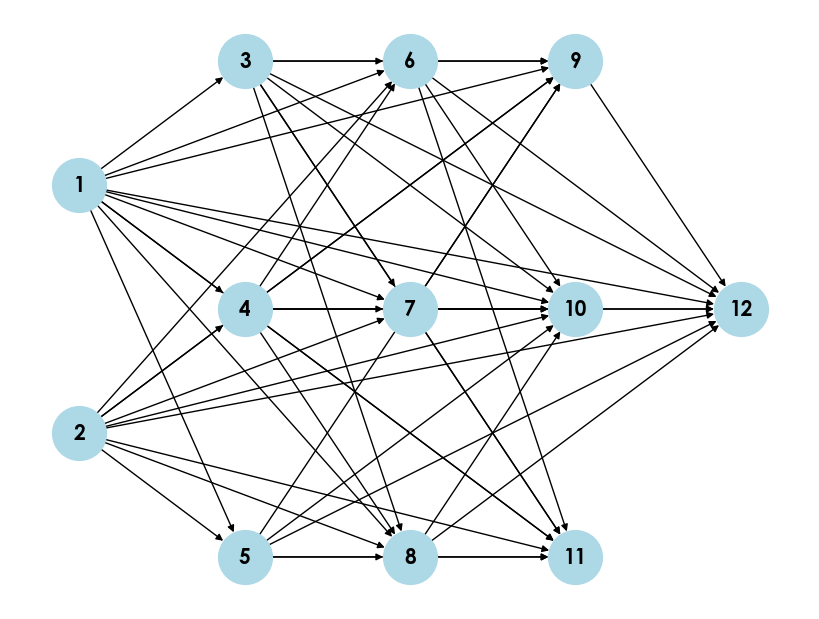

{'1': ['3', '4', '5', '6', '7', '8', '9', '10', '11', '12'], '2': ['4', '5', '6', '7', '8', '9', '10', '11', '12'], '3': ['6', '7', '8', '9', '10', '11', '12'], '4': ['6', '7', '8', '9', '10', '11', '12'], '5': ['8', '9', '10', '11', '12'], '6': ['9', '10', '11', '12'], '7': ['9', '10', '11', '12'], '8': ['10', '11', '12'], '9': ['12'], '10': [], '11': [], '12': []}


In [13]:
D = 0.9
n = 12

p_ij = generate_probabilities(D=D, n=n)
dict_graph = {}
g = generate_graph(n, p_ij, dict_graph)

visualize_graph(g, figure_size=(8,6))
print(dict_graph)

#### Some Simulations

D:0.0


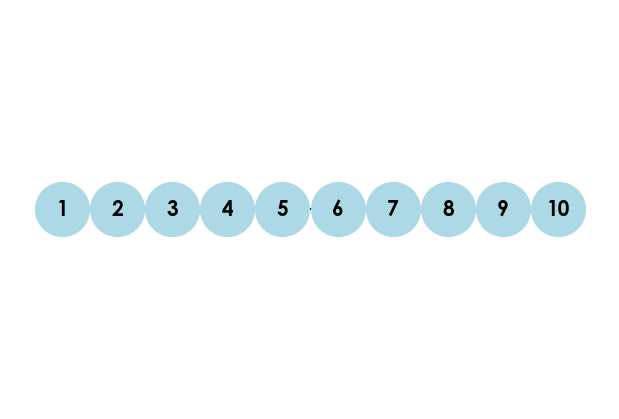

D:0.1


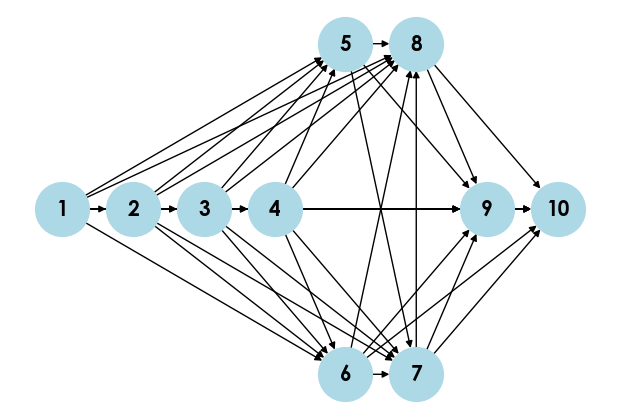

D:0.2


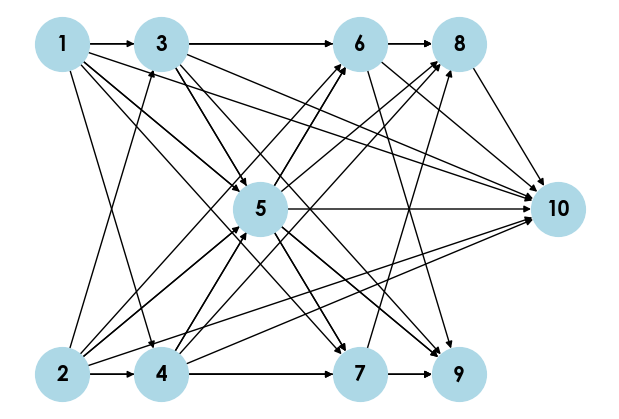

D:0.3


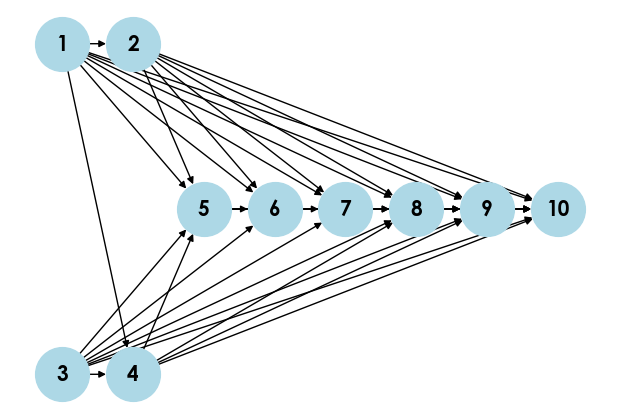

D:0.4


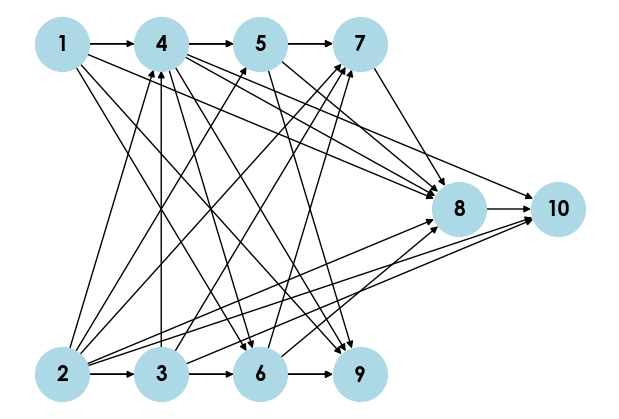

D:0.5


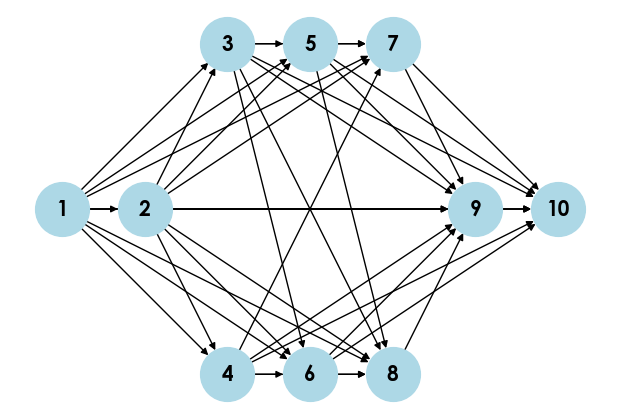

D:0.6


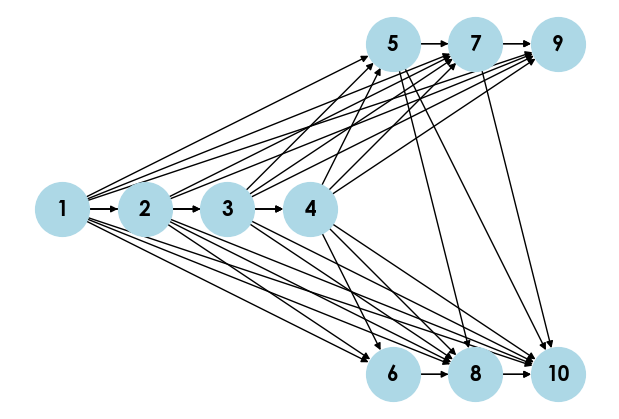

D:0.7


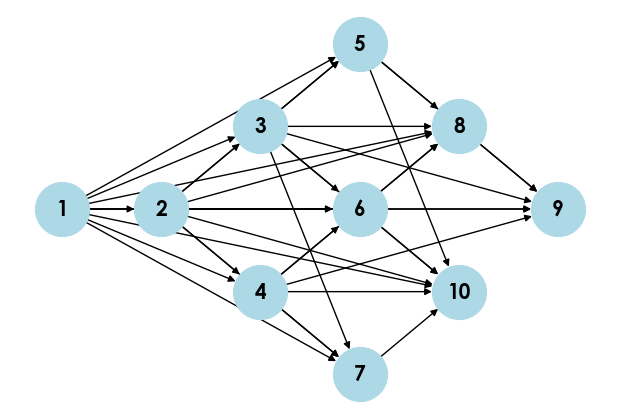

D:0.8


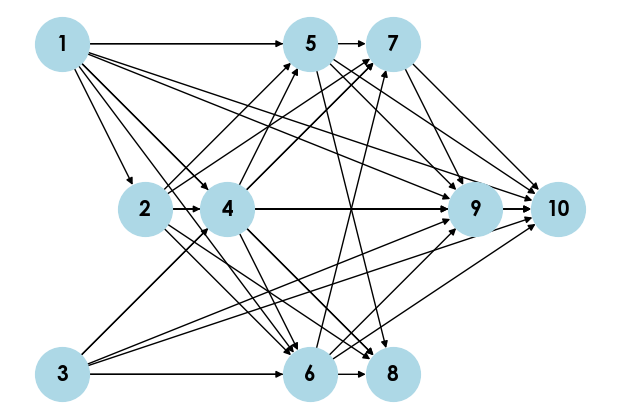

D:0.9


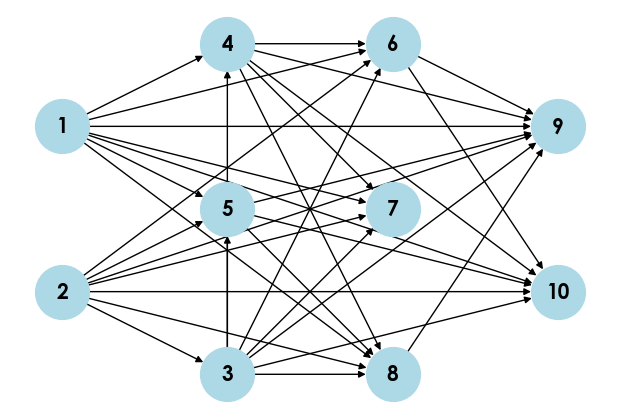

In [14]:
# Simulating how different values of D would affect the graph
for i in range(10):
    D = i/10
    n = 10
    print(f"D:{D}")
    p_ij = generate_probabilities(D=D, n=n)
    g = generate_graph(n, p_ij)
    visualize_graph(g, figure_size=(6,4))

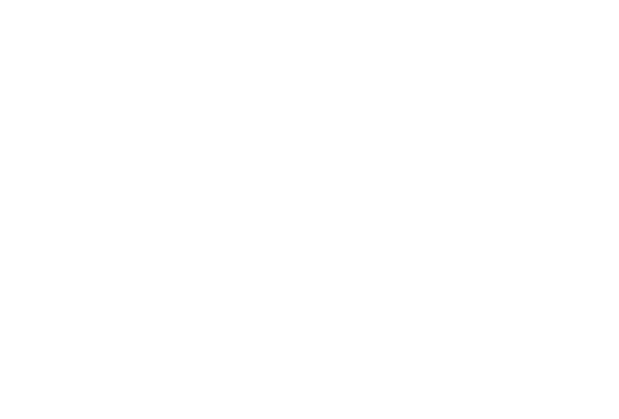

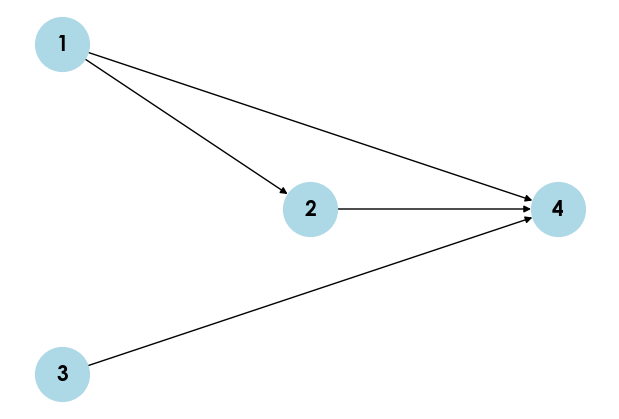

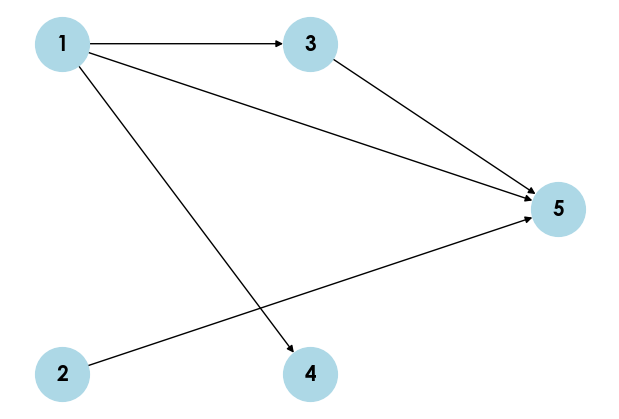

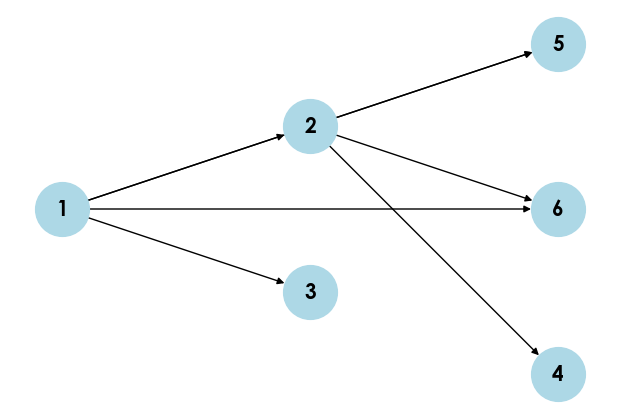

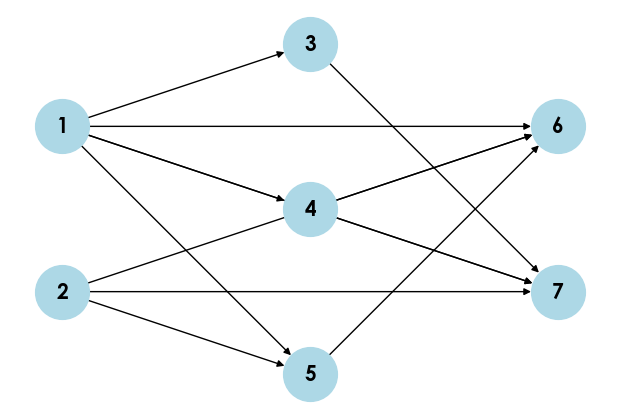

...

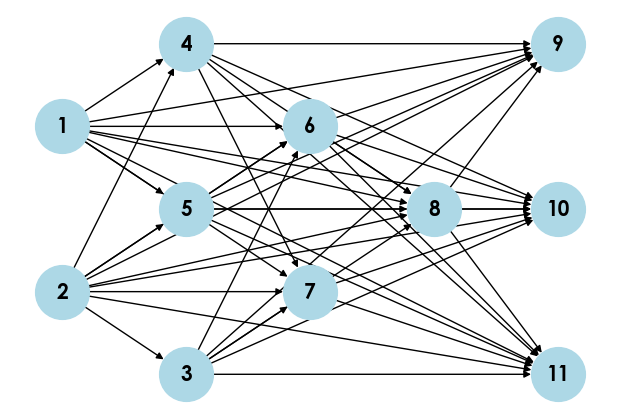

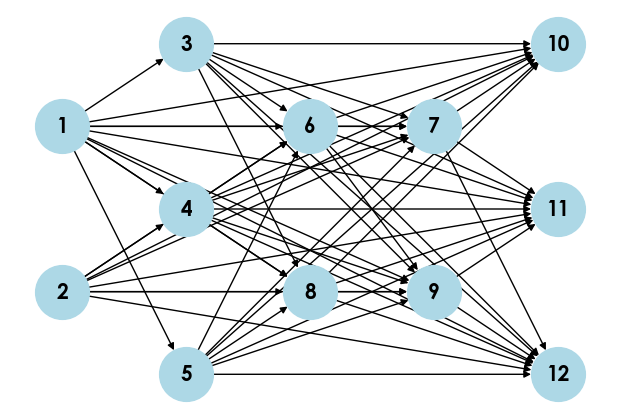

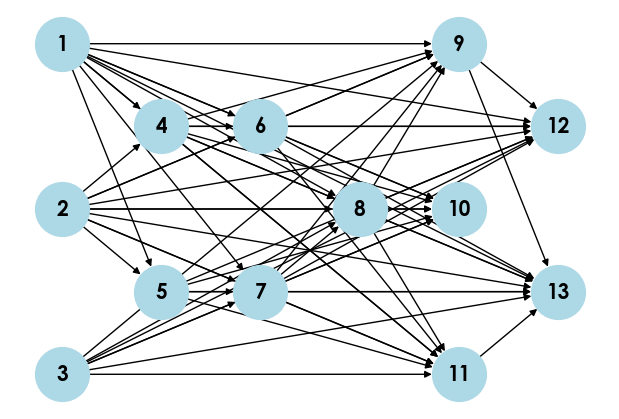

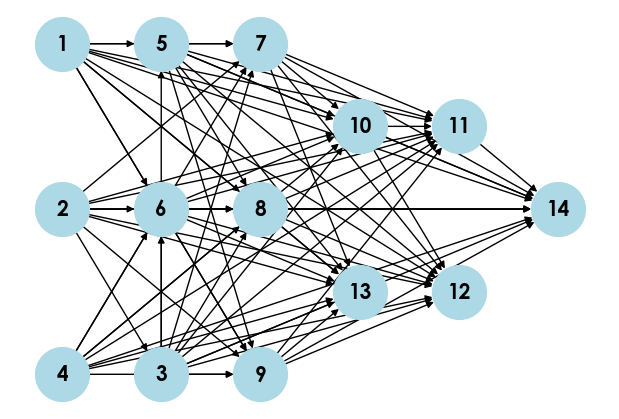

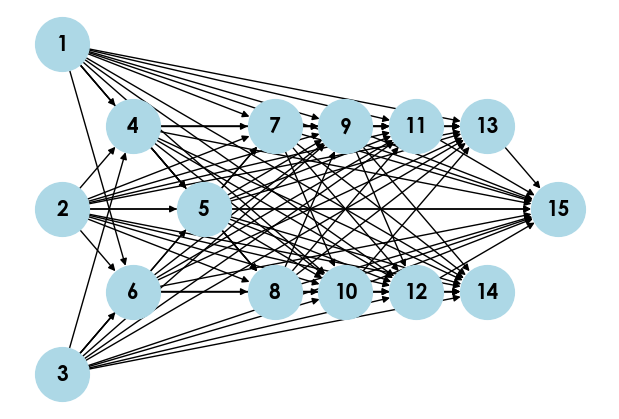

In [15]:
# Simulating how different values of n would affect the graph
D = 0.8
for n in range(3,16):
    p_ij = generate_probabilities(D=D, n=n)
    g = generate_graph(n, p_ij)
    visualize_graph(g, figure_size=(6,4))

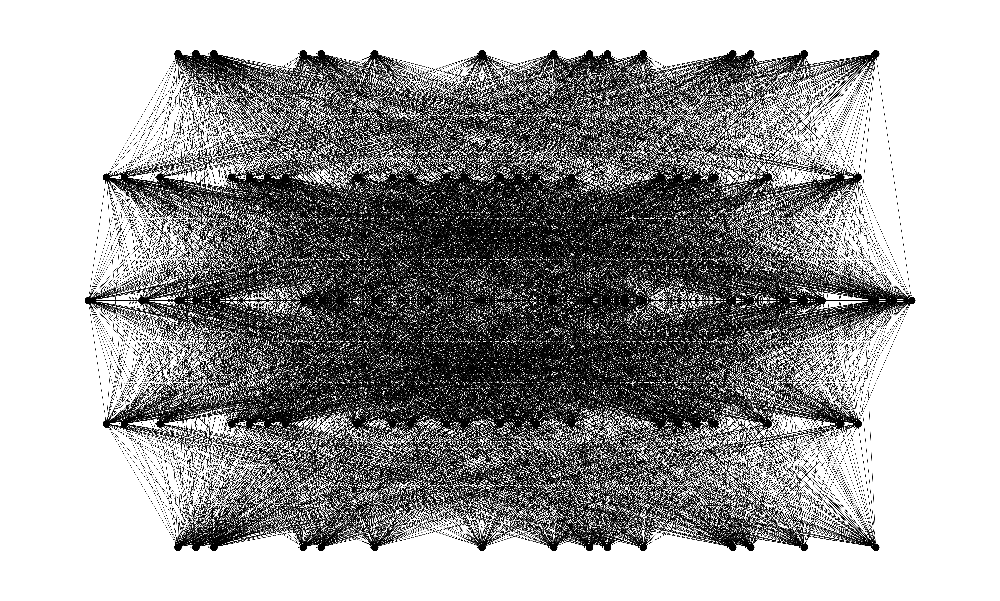

In [16]:
# Simulating the function for a very large n
n = 100
p_ij = generate_probabilities(D=D, n=n)
g = generate_graph(n, p_ij)
visualize_graph(g, figure_size=(50,30), node_color='black', node_size=700, edge_color='black')

# Generating Machine Speeds

### 01 First Try

In [3]:
class LogarithmicDistribution:
    def __init__(self, p):
        if not (0 < p < 1):
            raise ValueError("Parameter p must be between 0 and 1.")
        self.p = p

    def pmf(self, k):
        """Probability mass function of the logarithmic distribution."""
        if k < 1:
            return 0
        return -self.p**k / (k * np.log(1 - self.p))

    def sample(self, size=1):
        """Generate random samples from the logarithmic distribution."""
        # Using inverse transform sampling
        samples = []
        for _ in range(size):
            u = np.random.uniform(0, 1)
            k = 1
            sum_pmf = self.pmf(k)
            while u > sum_pmf:
                k += 1
                sum_pmf += self.pmf(k)
            samples.append(k)
        return np.array(samples)

    def plot_pmf(self, max_k=20):
        """Plot the probability mass function."""
        ks = np.arange(1, max_k + 1)
        pmf_values = [self.pmf(k) for k in ks]
        plt.stem(ks, pmf_values, use_line_collection=True)
        plt.xlabel('k')
        plt.ylabel('P(X=k)')
        plt.title('Logarithmic Distribution PMF')
        plt.show()

# Example usage:
p = 0.95
log_dist = LogarithmicDistribution(p)

# Generate random samples
samples = log_dist.sample(1000)

# Plot PMF
log_dist.plot_pmf()

plot_histogram(samples, bins=20, title='Histogram of Sample Numbers', xlabel='Number', ylabel='Frequency')

print(samples)

NameError: name 'np' is not defined

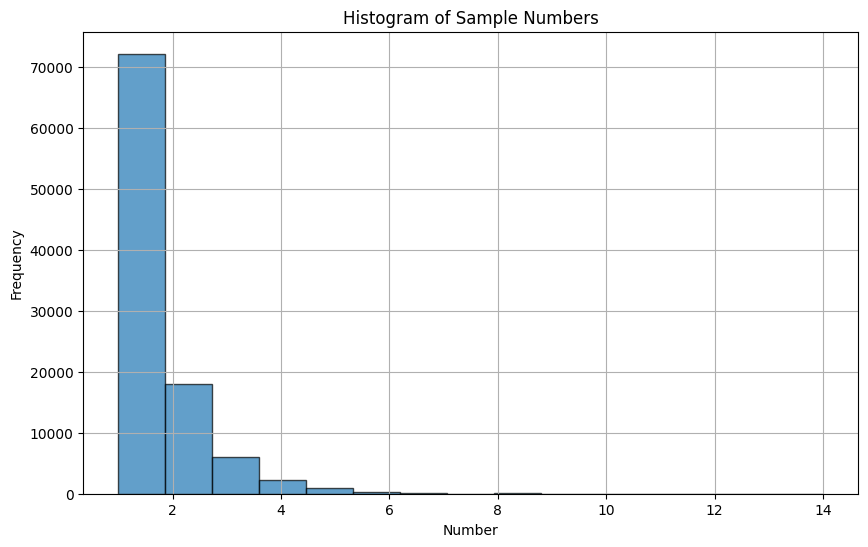

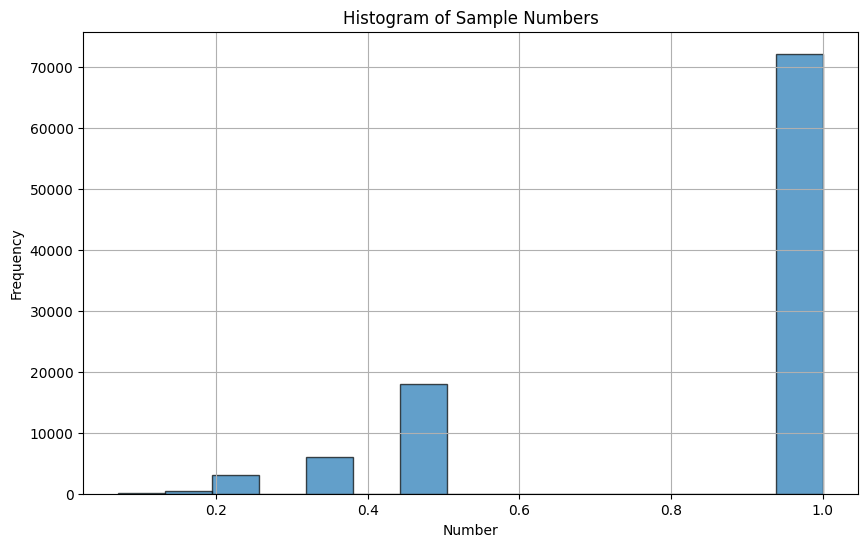

In [24]:
new_sample = []
for sample in samples: 
    new_sample.append(1/sample)


def plot_histogram(data, bins=10, title='Histogram', xlabel='Value', ylabel='Frequency'):
    """
    Plots a histogram of the given data.

    Parameters:
    - data: array-like, the input array of numbers.
    - bins: int, the number of bins for the histogram.
    - title: str, the title of the plot.
    - xlabel: str, the label for the x-axis.
    - ylabel: str, the label for the y-axis.
    """
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, edgecolor='black', alpha=0.7)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.grid(True)
    plt.show()

# Plotting the histogram
plot_histogram(samples, bins=15, title='Histogram of Sample Numbers', xlabel='Number', ylabel='Frequency')
plot_histogram(new_sample, bins=15, title='Histogram of Sample Numbers', xlabel='Number', ylabel='Frequency')


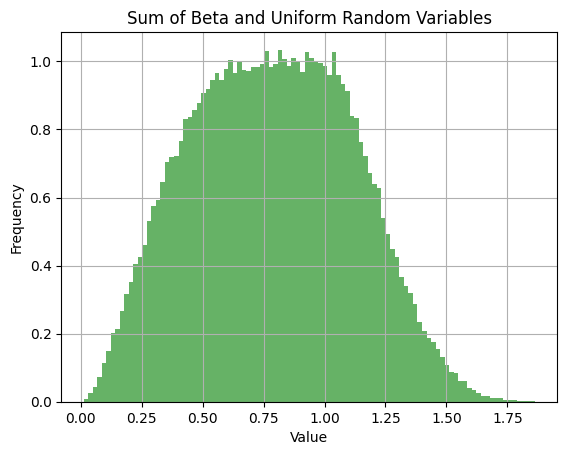

In [36]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import beta, uniform

# Parameters for Beta and Uniform distributions
alpha, beta_param = 2, 5
a, b = 0, 1

# Number of samples
n_samples = 100000

# Generate samples
X_samples = beta.rvs(alpha, beta_param, size=n_samples)
Y_samples = uniform.rvs(a, b-a, size=n_samples)

# Sum the samples
Z_samples = X_samples + Y_samples

# Plot the histogram
plt.hist(Z_samples, bins=100, density=True, alpha=0.6, color='g')

# Plot settings
plt.title('Sum of Beta and Uniform Random Variables')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


# Generating Machine Routings

### First Try

In [37]:
import numpy as np

def generate_transition_matrix(M, bottleneck_machine=None, bottleneck_probability=0.7):
    """
    Generate an initial transition probability matrix for M machines.
    Optionally, adjust the matrix to create a bottleneck at a specified machine.
    """
    matrix = np.random.rand(M, M)
    for i in range(M):
        matrix[i, :] /= matrix[i, :].sum()  # Normalize rows to sum to 1
    
    if bottleneck_machine is not None:
        for i in range(M):
            if i != bottleneck_machine:
                matrix[i, :] = (1 - bottleneck_probability) * matrix[i, :]
                matrix[i, bottleneck_machine] = bottleneck_probability
        for i in range(M):
            matrix[i, :] /= matrix[i, :].sum()  # Re-normalize rows
    
    return matrix

def generate_routings(N, M, transition_matrix):
    """
    Generate routings for N operations through M machines using the transition matrix.
    """
    routings = []
    for _ in range(N):
        routing = [np.random.choice(M)]  # Start with a random machine
        while len(routing) < M:
            current_machine = routing[-1]
            next_machine = np.random.choice(M, p=transition_matrix[current_machine])
            if next_machine not in routing:
                routing.append(next_machine)
            if len(set(routing)) == M:  # Stop if all machines have been visited
                break
        routings.append(routing)
    
    return routings

def main(N, M, bottleneck_machine=None, bottleneck_probability=0.7):
    transition_matrix = generate_transition_matrix(M, bottleneck_machine, bottleneck_probability)
    print("Transition Probability Matrix:")
    print(transition_matrix)
    routings = generate_routings(N, M, transition_matrix)
    print("\nGenerated Routings:")
    for i, routing in enumerate(routings):
        print(f"Operation {i+1}: {routing}")
        

# Parameters
N = 5  # Number of operations
M = 4  # Number of machines
bottleneck_machine = 2  # Index of the bottleneck machine (0 to M-1)
bottleneck_probability = 0.7  # Probability of routing to the bottleneck machine

main(N, M, bottleneck_machine, bottleneck_probability)


Transition Probability Matrix:
[[0.05252986 0.08682851 0.71866969 0.14197195]
 [0.13601579 0.11313667 0.71243561 0.03841192]
 [0.4913168  0.01203138 0.02097462 0.4756772 ]
 [0.07708014 0.0513651  0.73464858 0.13690619]]

Generated Routings:
Operation 1: [3, 2, 0, 1]
Operation 2: [2, 0, 3, 1]
Operation 3: [3, 0, 2, 1]
Operation 4: [3, 2, 0, 1]
Operation 5: [2, 3, 0, 1]


# Combining Everything

### Class and Function Definitions

#### 1. Graphs

In [38]:
class Vertex:
    def __init__(self, id_=""):
        self.id_ = id_
        self.neighbours = {}
    
    def add_neighbour(self, nbr_vertex, weight=0):
        self.neighbours[nbr_vertex] = weight
    
    def get_vertex_neighbours(self):
        return self.neighbours.keys()
    
    def get_weight(self, neighbour):
        if neighbour in self.neighbours.keys():
            return self.neighbours[neighbour]
        return None
    
    def __eq__(self, other):
        return self.id_ == other.id_

    def __lt__(self, other):
        return self.id_ < other.id_

    def __hash__(self):
        return hash(self.id_)
    
    def __str__(self):
        my_string = f"Vertex {self.id_} is connected to: "
        my_neighbours = [vertex.id_ for vertex in self.get_vertex_neighbours()]
        my_string += ", ".join(my_neighbours)
        return my_string
    
class Graph:
    def __init__(self):
        self.vertices = {}
        
    def _create_vertex(self, id_):
        return Vertex(id_)

    def add_vertex(self, id_):
        self.vertices[id_] = self._create_vertex(id_)

    def get_vertex(self, id_):
        return self.vertices.get(id_, None)
        
    def add_edge(self, start_v, end_v, weight=0):
        if start_v not in self.vertices: 
            self.add_vertex(start_v)
        if end_v not in self.vertices: 
            self.add_vertex(end_v)
        v_start = self.vertices[start_v]
        v_end = self.vertices[end_v]
        v_start.add_neighbour(v_end)

    def get_neighbours(self, id_):
        vertex = self.get_vertex(id_)
        if vertex:
            return [neighbour.id_ for neighbour in vertex.get_vertex_neighbours()]
        return []
 
    def __contains__(self, id_):
        return id_ in self.vertices
    
    def __iter__(self):
        return iter(self.vertices.values())

    @property        
    def num_vertices(self):
        return len(self.vertices)

In [39]:
def generate_probabilities(D=0.5, n=10):
    """ 
    Generates the probabilities of arc (i,j) existing for all i, j in n where i =/= j 
    Probability values are generated based on (Hall & Posner, 2001)
    Inputs: 
        - D          : float, value between 0 and 1 which sets the density of the graph
        - n          : int, number of nodes to be generated
    Output: 
        Returns p_ij, a dictionary which stores the probability values using the following data structure: 
            p_ij = { i: {j: p_ij} }
    """
    p_ij = {}
    n = int(n)
    for i in range(1, n+1):
        p_ij[i] = {}
        for j in range(1, n+1):
            if j != i: 
                p_ij[i][j] = D*(1-D)**(j-i-1) / (1 - D * (1 - (1-D)**(j-i-1) ))
    return p_ij 

def generate_graph(n, p_ij, dict_graph={}):
    """ 
    Generates a new graph with arcs and nodes that represent a BOM network. 
    The BOM network is generated based on a given set of probability values (Hall & Posner, 2001)
    Inputs: 
        - n          : int, number of nodes in the graph 
        - p_ij       : dict, probability of arc (i,j) existing (p_ij = { i: {j: p_ij}})
        - dict_graph : dict, alternative method to store graph information using adjacency matrix 
    Output: 
        - g          : graph object containing node and edges information
        - dict_graph : no output, but dict_graph is processed in place 
    Specific Features:
        - The graph generated does not contain self-connecting cycles
    """

    g = Graph()
    edges = []

    for i in range(1, n):
        dict_graph[str(i)] = []
        for j in range(i + 1, n + 1):
            dict_graph[str(j)] = []
            if p_ij[i][j] <= random.random():
                edges.append((i, j))

    for u, v in edges:
        u, v = str(u), str(v)
        if u < v:
            if not any(g.get_vertex(str(w)) for w in g.get_neighbours(v) if g.get_vertex(u) in g.get_neighbours(w)):
                g.add_edge(u, v)
                dict_graph[u].append(v)
        else:
            if not any(g.get_vertex(str(w)) for w in g.get_neighbours(u) if g.get_vertex(v) in g.get_neighbours(w)):
                g.add_edge(u, v)
                dict_graph[u].append(v)
    return g

def visualize_graph(graph, figure_size=(8, 6), font_type="Century Gothic", font_size=15, node_size=1500, node_color='lightblue', edge_color='black', alpha=1):
    """ 
    Generates a visualization for a graph object. The visualization is made in such a way that: 
        (1) Nodes with no immediate predecessors are placed to the left of the image
        (2) Nodes with no immediate successors are placed to the right of the image 
        (3) All other remaining nodes are placed in between. 
    Inputs (Required): 
        - graph         : graph object, containing the nodes and edges to be visualized
    Inputs (Optional):
        - figure_size   : tuple, sets the preferred size of the image
        - font_type     : str, sets the font family
        - font_size     : float, sets the size of the font
        - node_size     : float, sets the size of the nodes
        - node_color    : str, sets the color of the nodes
        - edge_color    : str, sets the color of the edges
        - edge_alpha    : float, value between 0 and 1 which sets the density of the edges
    Output: 
        - Visualization of the graph using plt.show()
    """
    G = nx.DiGraph()
    
    for vertex in graph:
        G.add_node(vertex.id_)
        for neighbour in vertex.get_vertex_neighbours():
            G.add_edge(vertex.id_, neighbour.id_)
    
    # Create custom positions for nodes
    pos = {}
    nodes_without_predecessors = [node for node in G.nodes if G.in_degree(node) == 0]
    nodes_without_successors = [node for node in G.nodes if G.out_degree(node) == 0]
    other_nodes = [node for node in G.nodes if node not in nodes_without_predecessors and node not in nodes_without_successors]
    
    # Assign layers
    layers = {node: 0 for node in nodes_without_predecessors}
    for node in other_nodes:
        predecessors = G.predecessors(node)
        layers[node] = max(layers[pred] + 1 for pred in predecessors if pred in layers)
    for node in nodes_without_successors:
        predecessors = G.predecessors(node)
        layers[node] = max(layers[pred] + 1 for pred in predecessors if pred in layers)
    
    # Add subset attribute to nodes
    for node, layer in layers.items():
        G.nodes[node]['subset'] = layer
    
    # Assign positions using multipartite_layout
    pos = nx.multipartite_layout(G, subset_key='subset')
    
    # Draw the graph with custom positions
    plt.figure(figsize=figure_size)
    nx.draw(G, pos, with_labels=True, font_family=font_type, font_weight='bold', font_size=font_size,
            node_color=node_color, node_size=node_size,  
            edge_color=edge_color, alpha=alpha)
    plt.show()

#### 2. Machine Speeds

In [1]:
class LogarithmicDistribution:
    def __init__(self, p):
        if not (0 < p < 1):
            raise ValueError("Parameter p must be between 0 and 1.")
        self.p = p

    def pmf(self, k):
        """Probability mass function of the logarithmic distribution."""
        if k < 1:
            return 0
        return -self.p**k / (k * np.log(1 - self.p))

    def sample(self, size=1):
        """Generate random samples from the logarithmic distribution."""
        # Using inverse transform sampling
        samples = []
        for _ in range(size):
            u = np.random.uniform(0, 1)
            k = 1
            sum_pmf = self.pmf(k)
            while u > sum_pmf:
                k += 1
                sum_pmf += self.pmf(k)
            samples.append(k)
        return np.array(samples)

    def plot_pmf(self, max_k=20):
        """Plot the probability mass function."""
        ks = np.arange(1, max_k + 1)
        pmf_values = [self.pmf(k) for k in ks]
        plt.stem(ks, pmf_values, use_line_collection=True)
        plt.xlabel('k')
        plt.ylabel('P(X=k)')
        plt.title('Logarithmic Distribution PMF')
        plt.show()

In [2]:
def plot_histogram(data, bins=10, title='Histogram', xlabel='Value', ylabel='Frequency'):
    """
    Plots a histogram of the given data.

    Parameters:
    - data: array-like, the input array of numbers.
    - bins: int, the number of bins for the histogram.
    - title: str, the title of the plot.
    - xlabel: str, the label for the x-axis.
    - ylabel: str, the label for the y-axis.
    """
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, edgecolor='black', alpha=0.7)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.grid(True)
    plt.show()


#### 3. Machine Routing

In [43]:
def generate_transition_matrix(M, bottleneck_machine=None, bottleneck_probability=0.7):
    """
    Generate an initial transition probability matrix for M machines.
    Optionally, adjust the matrix to create a bottleneck at a specified machine.
    """
    matrix = np.random.rand(M, M)
    for i in range(M):
        matrix[i, :] /= matrix[i, :].sum()  # Normalize rows to sum to 1
    
    if bottleneck_machine is not None:
        for i in range(M):
            if i != bottleneck_machine:
                matrix[i, :] = (1 - bottleneck_probability) * matrix[i, :]
                matrix[i, bottleneck_machine] = bottleneck_probability
        for i in range(M):
            matrix[i, :] /= matrix[i, :].sum()  # Re-normalize rows
    
    return matrix

def generate_routings(N, M, transition_matrix):
    """
    Generate routings for N operations through M machines using the transition matrix.
    """
    routings = []
    for _ in range(N):
        routing = [np.random.choice(M)]  # Start with a random machine
        while len(routing) < M:
            current_machine = routing[-1]
            next_machine = np.random.choice(M, p=transition_matrix[current_machine])
            if next_machine not in routing:
                routing.append(next_machine)
            if len(set(routing)) == M:  # Stop if all machines have been visited
                break
        routings.append(routing)
    
    return routings

def main(N, M, bottleneck_machine=None, bottleneck_probability=0.7):
    transition_matrix = generate_transition_matrix(M, bottleneck_machine, bottleneck_probability)
    print("Transition Probability Matrix:")
    print(transition_matrix)
    routings = generate_routings(N, M, transition_matrix)
    print("\nGenerated Routings:")
    for i, routing in enumerate(routings):
        print(f"Operation {i+1}: {routing}")


### Generating a Complete Dataset

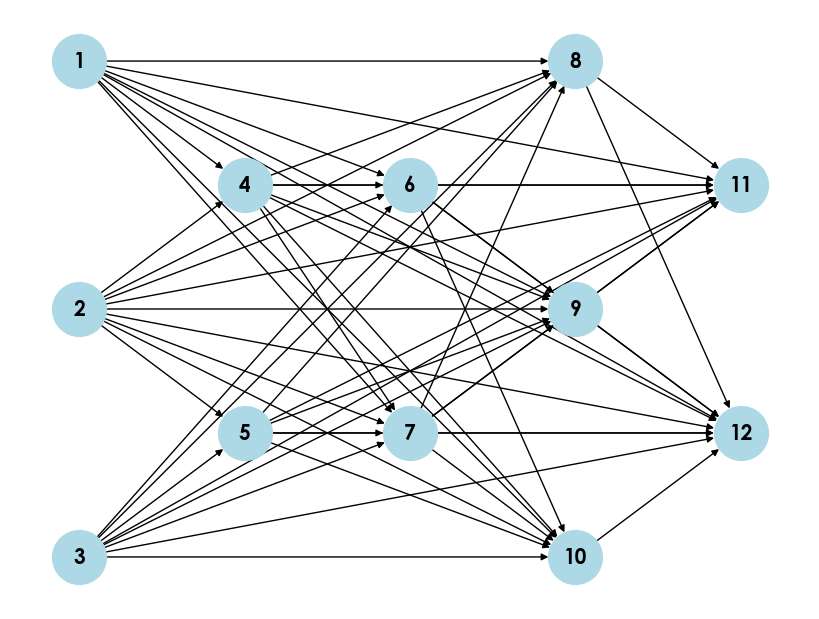

,operation,predecessors
0,1,[]
1,2,[]
2,3,[]
3,4,"[1, 2]"
4,5,"[2, 3]"
5,6,"[1, 2, 3, 4]"
6,7,"[1, 2, 3, 4, 5]"
7,8,"[1, 2, 3, 4, 5, 7]"
8,9,"[1, 2, 3, 4, 5, 6, 7]"
9,10,"[1, 2, 3, 4, 5, 6, 7]"


In [80]:
D = 0.9
n = 12

p_ij = generate_probabilities(D=D, n=n)
dict_graph = {}
g = generate_graph(n, p_ij, dict_graph)

visualize_graph(g, figure_size=(8,6))
# print(dict_graph)
# print("predecessor", "[successors]")
# for key in dict_graph: 
#     print(key, dict_graph[key])

reversed_graph = {str(i): [] for i in range(1, len(dict_graph))}
for predecessor, successors in dict_graph.items():
    for successor in successors:
        reversed_graph.setdefault(successor, []).append(predecessor)

# print("successor", "[predecessors]")
# for successor in reversed_graph:
#     print(successor, reversed_graph[successor])

df = pd.DataFrame({
    # "part": [None],
    "operation": [None],
    "predecessors": [None]
})

i = 0
for successor in reversed_graph.keys():
    df.at[i, "operation"] = successor
    df.at[i,"predecessors"] = reversed_graph[successor]
    i += 1
display(df)

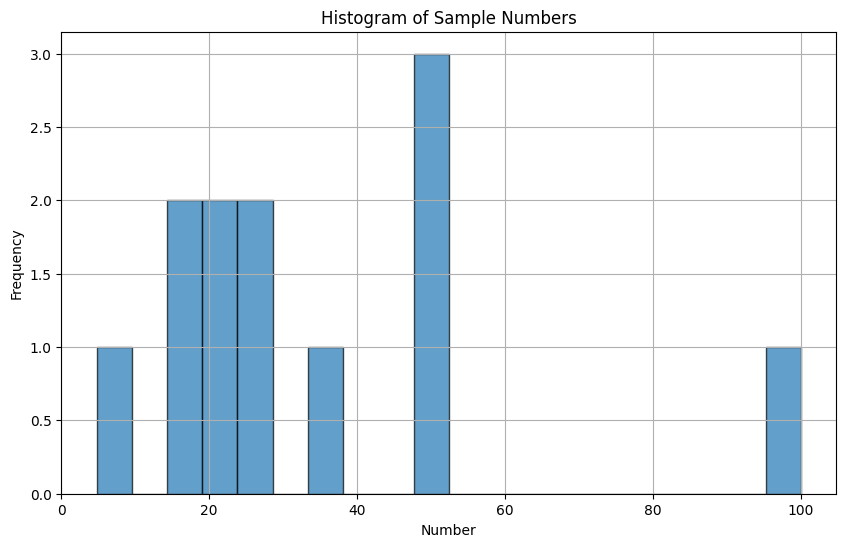

In [94]:
p = 0.95
log_dist = LogarithmicDistribution(p)
samples = 100/log_dist.sample(n)
plot_histogram(samples, bins=20, title='Histogram of Sample Numbers', xlabel='Number', ylabel='Frequency')

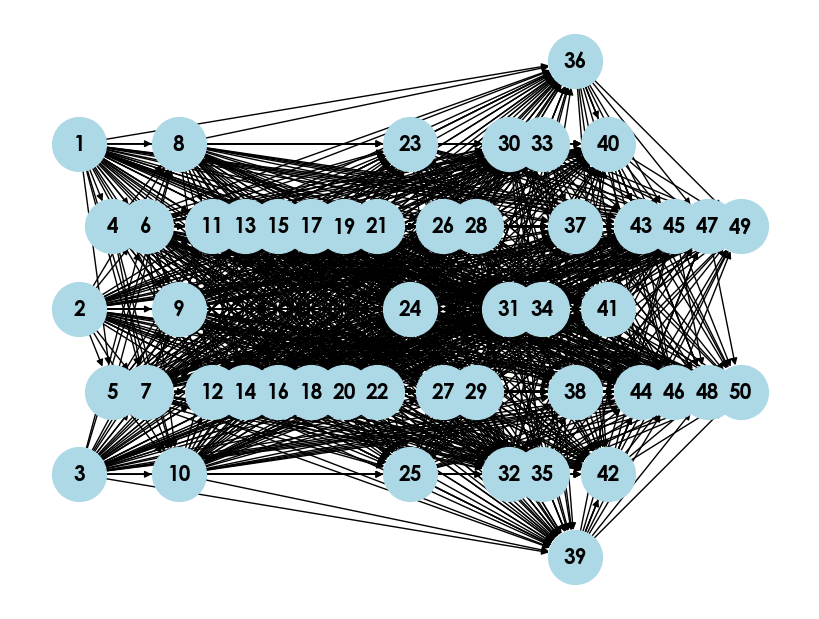

{'1': ['4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50'], '2': ['5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50'], '3': ['6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50'], '4': ['6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '

,operation,predecessors,machine
0,1,[],3
1,2,[],2
2,3,[],2
3,4,[1],4
4,5,"[1, 2]",1
5,6,"[1, 2, 3, 4]",2
6,7,"[1, 2, 3, 4, 5]",2
7,8,"[1, 2, 3, 4, 5, 6]",3
8,9,"[1, 2, 3, 4, 5, 6, 7]",2
9,10,"[1, 2, 3, 4, 5, 6, 7]",2


In [101]:
def generate_transition_matrix(M, bottleneck_machine=None, bottleneck_probability=0.3):
    """
    Generate a transition matrix for machine assignments.
    Inputs:
    - M: int, number of machines
    - bottleneck_machine: int or None, index of the bottleneck machine (0-indexed)
    - bottleneck_probability: float, probability that the bottleneck machine will be chosen
    Output:
    - transition_matrix: numpy array of shape (M, M) containing transition probabilities
    """
    transition_matrix = np.ones((M, M))
    if bottleneck_machine is not None:
        transition_matrix[:, bottleneck_machine] = bottleneck_probability
        other_probability = (1 - bottleneck_probability) / (M - 1)
        for i in range(M):
            if i != bottleneck_machine:
                transition_matrix[:, i] = other_probability
    transition_matrix = transition_matrix / transition_matrix.sum(axis=1)[:, np.newaxis]
    return transition_matrix

def assign_machines(df, M, bottleneck_machine=None, bottleneck_probability=0.3):
    """
    Assign machines to operations based on a transition probability matrix.
    Inputs:
    - df: DataFrame, containing the operations and their predecessors
    - M: int, number of machines
    - bottleneck_machine: int or None, index of the bottleneck machine (0-indexed)
    - bottleneck_probability: float, probability that the bottleneck machine will be chosen
    Output:
    - df: DataFrame, with an additional column "machine" assigned
    """
    transition_matrix = generate_transition_matrix(M, bottleneck_machine, bottleneck_probability)
    current_machine = random.randint(0, M - 1)  # Start with a random machine

    machine_assignments = []
    for _ in range(len(df)):
        next_machine = np.random.choice(M, p=transition_matrix[current_machine])
        machine_assignments.append(next_machine)
        current_machine = next_machine
    
    df['machine'] = machine_assignments
    return df

D = 0.9
n = 50
M = 5  # Number of machines
bottleneck_machine = 2  # Example bottleneck machine index

p_ij = generate_probabilities(D=D, n=n)
dict_graph = {}
g = generate_graph(n, p_ij, dict_graph)

visualize_graph(g, figure_size=(8, 6))

print(dict_graph)
print("predecessor", "[successors]")
for key in dict_graph:
    print(key, dict_graph[key])

reversed_graph = {str(i): [] for i in range(1, len(dict_graph))}
for predecessor, successors in dict_graph.items():
    for successor in successors:
        reversed_graph.setdefault(successor, []).append(predecessor)

print("successor", "[predecessors]")
for successor in reversed_graph:
    print(successor, reversed_graph[successor])

df = pd.DataFrame({
    "operation": [None],
    "predecessors": [None]
})

i = 0
for successor in reversed_graph.keys():
    df.at[i, "operation"] = successor
    df.at[i, "predecessors"] = reversed_graph[successor]
    i += 1

df = assign_machines(df, M, bottleneck_machine, bottleneck_probability=0.7)
display(df)
